In [ ]:
import heapq

class Nodo:
    def __init__(self, estado, padre=None, accion=None, costo=0):
        self.estado = estado
        self.padre = padre
        self.accion = accion
        self.costo = costo
class Frontera:
    def __init__(self, tipo):
        self.tipo = tipo
        if tipo == "A*":
            self.frontera = []
            self.contador = 0
        else:
            self.frontera = []

    def empty(self):
        return len(self.frontera) == 0

    def add(self, nodo, prioridad=0):
        if self.tipo == "A*":
            heapq.heappush(self.frontera, (prioridad, self.contador, nodo))
            self.contador += 1
        else:
            self.frontera.append(nodo)

    def eliminar(self):
        if self.empty():
            raise Exception("Frontera vacía")
        if self.tipo == "FIFO":
            return self.frontera.pop(0)
        elif self.tipo == "LIFO":
            return self.frontera.pop()
        elif self.tipo == "A*":
            return heapq.heappop(self.frontera)[2]

    def contiene_estado(self, estado):
        if self.tipo == "A*":
            return any(nodo.estado == estado for _, _, nodo in self.frontera)
        else:
            return any(nodo.estado == estado for nodo in self.frontera)

class Deslizante:
    def __init__(self, filename, metodo="FIFO"):
        with open(filename, 'r') as file:
            contenido = file.read().split(';')
        self.inicio = [[int(num) for num in linea.split(',')] for linea in contenido]
        self.n = len(self.inicio)
        self.objetivo = [[(i * self.n + j + 1) % (self.n * self.n) for j in range(self.n)] for i in range(self.n)]
        self.metodo = metodo
        self.explorados = set()
    def Ninversiones(self, estado):
        plano = [num for fila in estado for num in fila if num != 0]
        inversiones = 0
        for i in range(len(plano)):
            for j in range(i + 1, len(plano)):
                if plano[i] > plano[j]:
                    inversiones += 1
        return inversiones % 2 == 0, inversiones


    def heuristica_manhattan(self, estado):
        distancia = 0
        for i in range(self.n):
            for j in range(self.n):
                valor = estado[i][j]
                if valor != 0:
                    objetivo_i = (valor - 1) // self.n
                    objetivo_j = (valor - 1) % self.n
                    distancia += abs(i - objetivo_i) + abs(j - objetivo_j)
        return distancia

    def calcular_costo(self, nodo):
        costo = 0
        while nodo.padre is not None:
            nodo = nodo.padre
            costo += 1
        return costo

    def vecinos(self, estado):
        fil, col = next((i, j) for i, fila in enumerate(estado) for j, val in enumerate(fila) if val == 0)
        movimientos = [("Arriba", (fil - 1, col)), ("Abajo", (fil + 1, col)), ("Izquierda", (fil, col - 1)), ("Derecha", (fil, col + 1))]
        return [(accion, (f, c)) for accion, (f, c) in movimientos if 0 <= f < self.n and 0 <= c < self.n]

    def mover(self, estado, nueva_pos):
        fil_cero, col_cero = next((i, j) for i, fila in enumerate(estado) for j, val in enumerate(fila) if val == 0)
        fil_nueva, col_nueva = nueva_pos
        nuevo_estado = [fila[:] for fila in estado]
        nuevo_estado[fil_cero][col_cero], nuevo_estado[fil_nueva][col_nueva] = nuevo_estado[fil_nueva][col_nueva], 0
        return nuevo_estado

    def imprimir_camino(self, nodo):
        camino = []
        while nodo:
            camino.append((nodo.accion, nodo.estado))
            nodo = nodo.padre
        camino = list(reversed(camino))
        for i, (accion, estado) in enumerate(camino):
            if i == 0:
                print("Estado inicial:")
            else:
                print(f"Acción: {accion}")
            for fila in estado:
                print(fila)
            print()

    def solver(self):
        resoluble, inversiones = self.Ninversiones(self.inicio)
        print(f"Número de inversiones: {inversiones}")
    
        if not resoluble:
            print("Este deslizante NO se puede resolver")
            return

        frontera = Frontera(tipo=self.metodo)
        nodo_inicio = Nodo(self.inicio)
        if self.metodo == "A*":
            heuristica = self.heuristica_manhattan(self.inicio)
            frontera.add(nodo_inicio, heuristica)
        else:
            frontera.add(nodo_inicio)

        while not frontera.empty():
            nodo_actual = frontera.eliminar()

            if nodo_actual.estado == self.objetivo:
                self.imprimir_camino(nodo_actual)
                return

            self.explorados.add(tuple(tuple(fila) for fila in nodo_actual.estado))

            for accion, nueva_pos in self.vecinos(nodo_actual.estado):
                nuevo_estado = self.mover(nodo_actual.estado, nueva_pos)
                if tuple(tuple(fila) for fila in nuevo_estado) in self.explorados:
                    continue
                if frontera.contiene_estado(nuevo_estado):
                    continue

                nuevo_nodo = Nodo(nuevo_estado, nodo_actual, accion)
                if self.metodo == "A*":
                    costo_real = self.calcular_costo(nuevo_nodo)
                    heuristica = self.heuristica_manhattan(nuevo_estado)
                    frontera.add(nuevo_nodo, costo_real + heuristica)
                else:
                    frontera.add(nuevo_nodo)

In [11]:
if __name__ == "__main__":
    metodo = "A*"  # FIFO, LIFO, A*
    archivo = "deslizantes/deslizante6.txt"
    deslizante = Deslizante(archivo, metodo=metodo)
    deslizante.solver()


Número de inversiones: 1
Este tablero NO se puede resolver


In [ ]:
import time

archivos = [f"deslizantes/deslizante{i}.txt" for i in range(1, 6)]
metodos = ["FIFO", "LIFO", "A*"]
resultados = {metodo: [] for metodo in metodos}

for metodo in metodos:
    print(f"\nEjecutando con método: {metodo}")
    for archivo in archivos:
        inicio = time.time()
        puzzle = Deslizante(archivo, metodo=metodo)
        puzzle.solver()
        fin = time.time()
        duracion = fin - inicio
        resultados[metodo].append(duracion)
        print(f"{archivo} -> {duracion:.4f} segundos")

print("\n--- Resumen de tiempos ---")
for metodo in metodos:
    tiempos = resultados[metodo]
    promedio = sum(tiempos) / len(tiempos)
    total = sum(tiempos)
    print(f"{metodo}: promedio = {promedio:.4f}s, total = {total:.4f}s")



Ejecutando con método: FIFO
Estado inicial:
[0, 2, 3]
[1, 4, 5]
[6, 7, 8]

Acción: Abajo
[1, 2, 3]
[0, 4, 5]
[6, 7, 8]

Acción: Derecha
[1, 2, 3]
[4, 0, 5]
[6, 7, 8]

Acción: Derecha
[1, 2, 3]
[4, 5, 0]
[6, 7, 8]

Acción: Abajo
[1, 2, 3]
[4, 5, 8]
[6, 7, 0]

Acción: Izquierda
[1, 2, 3]
[4, 5, 8]
[6, 0, 7]

Acción: Izquierda
[1, 2, 3]
[4, 5, 8]
[0, 6, 7]

Acción: Arriba
[1, 2, 3]
[0, 5, 8]
[4, 6, 7]

Acción: Derecha
[1, 2, 3]
[5, 0, 8]
[4, 6, 7]

Acción: Abajo
[1, 2, 3]
[5, 6, 8]
[4, 0, 7]

Acción: Derecha
[1, 2, 3]
[5, 6, 8]
[4, 7, 0]

Acción: Arriba
[1, 2, 3]
[5, 6, 0]
[4, 7, 8]

Acción: Izquierda
[1, 2, 3]
[5, 0, 6]
[4, 7, 8]

Acción: Izquierda
[1, 2, 3]
[0, 5, 6]
[4, 7, 8]

Acción: Abajo
[1, 2, 3]
[4, 5, 6]
[0, 7, 8]

Acción: Derecha
[1, 2, 3]
[4, 5, 6]
[7, 0, 8]

Acción: Derecha
[1, 2, 3]
[4, 5, 6]
[7, 8, 0]

deslizantes/deslizante1.txt -> 32.3476 segundos
Estado inicial:
[0, 1, 3]
[4, 2, 5]
[7, 8, 6]

Acción: Derecha
[1, 0, 3]
[4, 2, 5]
[7, 8, 6]

Acción: Abajo
[1, 2, 3]
[4, 0, 5

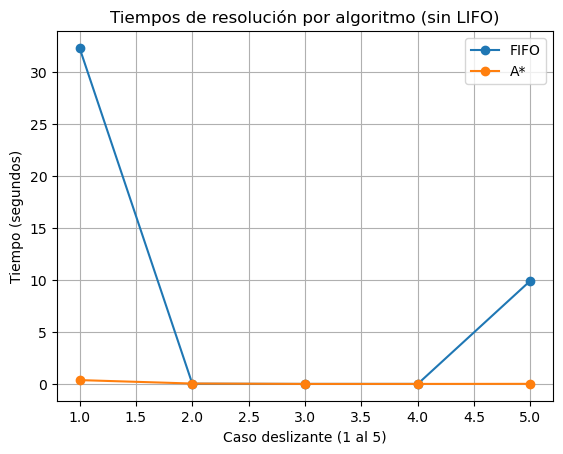

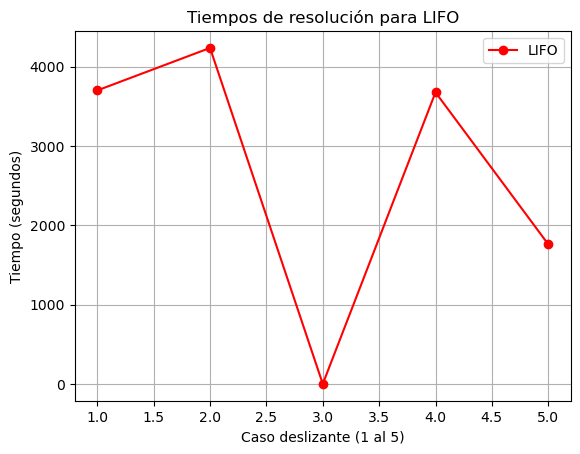

In [ ]:
import matplotlib.pyplot as plt

for metodo in metodos:
    if metodo != "LIFO":
        plt.plot(range(1, 6), resultados[metodo], marker='o', label=metodo)

plt.title("Tiempos de resolución por algoritmo (sin LIFO)")
plt.xlabel("Caso deslizante (1 al 5)")
plt.ylabel("Tiempo (segundos)")
plt.legend()
plt.grid(True)
plt.show()

plt.plot(range(1, 6), resultados["LIFO"], marker='o', label="LIFO", color='red')
plt.title("Tiempos de resolución para LIFO")
plt.xlabel("Caso deslizante (1 al 5)")
plt.ylabel("Tiempo (segundos)")
plt.legend()
plt.grid(True)
plt.show()